# Setup

## Imports

In [ ]:
%load_ext autoreload
%autoreload 2

import os
import sys
import time
import warnings
import numpy as np
import torch
import pickle as pkl
import cv2
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import datamapplot
import umap
import hdbscan
import joblib

from pathlib import Path
from collections import defaultdict
from importlib import reload
from tqdm import tqdm
from hdbscan.validity import validity_index
from sklearn.manifold import trustworthiness
from sklearn.decomposition import PCA
from sklearn import preprocessing
from scipy import stats

warnings.filterwarnings('ignore')

### EDIT PATH ###
base_dir = Path("/path/to/repository/dreamachine_clustering")
image_dir = Path("/path/to/dreamachine_images/dreamachine_drawings")

# Ensure paths exist
assert base_dir.exists(), "Update repo_root"
assert image_dir.exists(), "Update image_dir"

# Import uility functions (after setting base_dir)
import utils

# Repo-relative paths (do not change)
outputs_dir = base_dir / "outputs"
cache_dir = outputs_dir / "cache"
feature_vector_path = base_dir / "embeddings/feature_vectors_dict_DM_full_dino_48_augmentations_05092024.pt"
labels_path = base_dir / "data/cluster_labels.xlsx"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Loading Image Paths and Feature Vectors

In [57]:
# Images
filenames = os.listdir(image_dir) # list of all images in the directory

# Sprite Images
sprite = str(outputs_dir / "sprite_image.png")

# Feature Vector Dictionaries (img_filename:feature_vector)
dino_dict = torch.load(feature_vector_path)

# model name
model_name = 'dino'

# dictionary of feature_vectors dictionaries - {img_filename:feature_vector}
model_dict = {'dict': dino_dict,
                   'filenames': filenames,
                   'image_dir': image_dir,
                   'sprite': sprite
                  }

# getting dictionary of feature vectors in order of filenames
fv = {} # feature vectors

feat_dict = model_dict['dict']
vectors = [feat_dict[filename] for filename in model_dict['filenames'] if filename.endswith(('.jpg', '.jpeg'))]

fv[model_name] = vectors

## L2 Normalization

In [58]:
fv["l2"] = preprocessing.normalize(fv["dino"], norm='l2')

# Generate Sprite From Dreamachine Images

In [59]:
image_size = (50, 50)  # Size to which each image will be resized

sprite = str(outputs_dir / "sprite_image.png")
utils.create_sprite(filenames, image_dir, sprite, image_size)

# Dimensionality Reduction

## PCA

dino
Number of feature vectors: 9700
(9700, 1024)


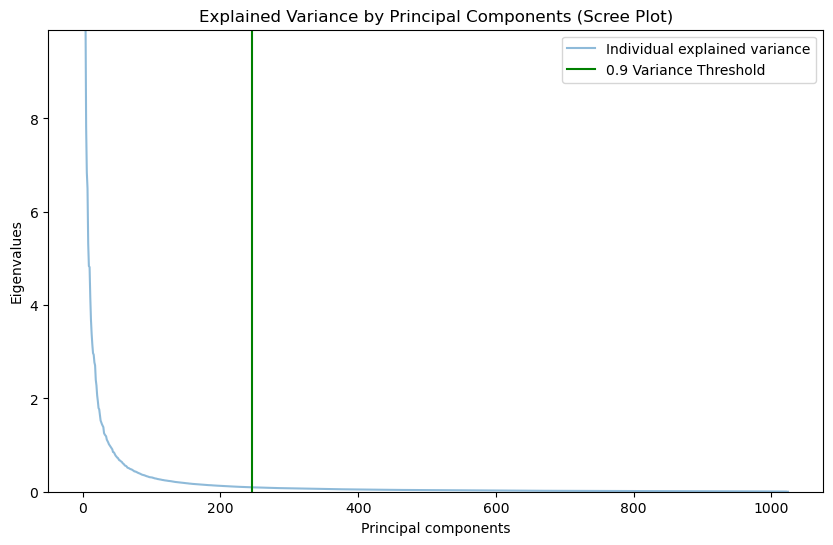

Original feature vector shape: (9700, 1024)
Reduced feature vector shape: (9700, 246)
Number of components to retain (to reach 0.9 variance explained): 246
l2
Number of feature vectors: 9700
(9700, 1024)


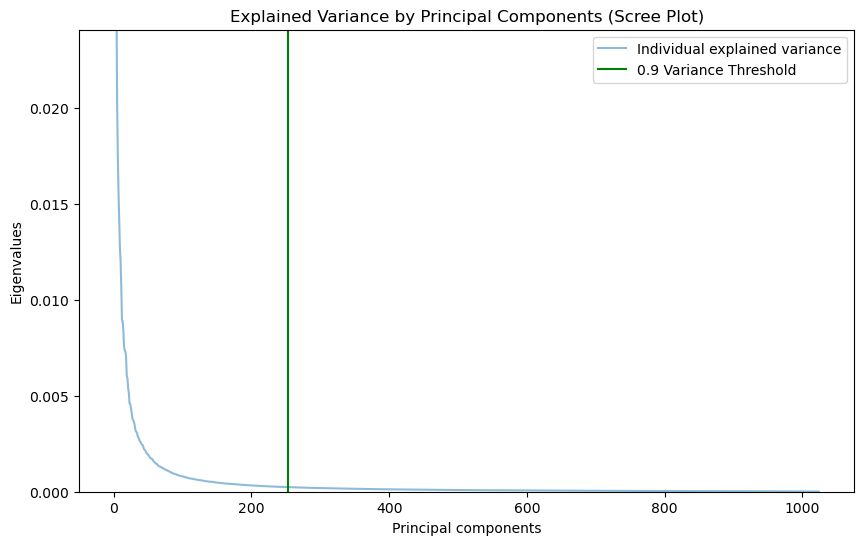

Original feature vector shape: (9700, 1024)
Reduced feature vector shape: (9700, 253)
Number of components to retain (to reach 0.9 variance explained): 253
253
dict_keys(['dino', 'l2'])


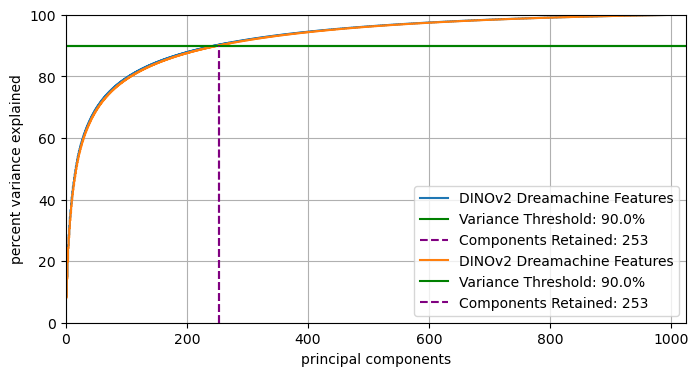

In [66]:
fv_reduced = {}
fv_whitened = {}
fv_explained_variance = {}

variance_threshold = [0.9]

# Print Individual Explained Variance Graphs
for name, vectors in fv.items():
        print(name)
        print('Number of feature vectors:', len(vectors))
        print(np.array(vectors).shape)

        for variance in variance_threshold:

                (vectors_reduced,
                vectors_whitened,
                explained_variance,
                num_components) = utils.print_pca_variations(vectors,
                                                        variance_threshold=variance,
                                                        show=True,
                                                        ratio=False)

                variance_name = '0_' + str(np.round(variance, 2)).split('.')[-1]

                fv_reduced[name] = vectors_reduced # feature vectors with cumulative explained variance > variance threshold
                fv_whitened[name] = vectors_whitened # whitened (spherized/normalized) feature vectors with cumulative explained variance > variance threshold
                fv_explained_variance[name] = explained_variance

print(num_components)

plt.figure(figsize=(8, 4))
for idx, (name, explained_variance) in enumerate(fv_explained_variance.items()):
        cumulative_variance = np.cumsum(explained_variance)  # Compute the cumulative sum of explained variance ratios

        plt.step(range(1, len(cumulative_variance) + 1), cumulative_variance * 100, where='mid', label=f'DINOv2 Dreamachine Features')
        plt.axhline(y=variance_threshold[0]*100, color='green', label=f"Variance Threshold: {variance_threshold[0] * 100:.1f}%")
        plt.axvline(x=num_components, ymax=variance_threshold[0], color='purple', ls='--', label=f'Components Retained: {num_components}')
        plt.ylim(0, 100)
        plt.xlim(0, 1024)
        plt.grid(True)
        plt.legend(loc='lower right')
        plt.xlabel('principal components')
        plt.ylabel('percent variance explained')

print(fv_reduced.keys())

## UMAP

### Evaluating Trustworthiness (UMAP Metric) looking at Components parameter

(9700, 253)
NN: 25
--------------------------------------------------
trust n_neighbors: 25
trust n_neighbors: 50
trust n_neighbors: 75


KeyboardInterrupt: 

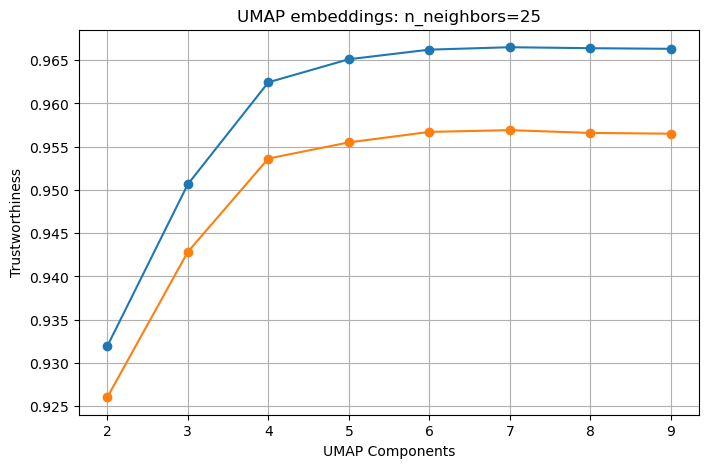

In [61]:
def evaluate_umap_embeddings(
        vectors,
        components,
        n_neighbors_range,
        trustworthiness_nn,
        metric="cosine",
        random_state=None):

    for n_neighbors in n_neighbors_range:

        print("NN:", n_neighbors)
        print(50*"-")

        plt.figure(figsize=(8, 5))
        plt.ylabel(f"Trustworthiness")
        plt.xlabel("UMAP Components")
        plt.title("UMAP embeddings: n_neighbors=" + str(n_neighbors))
        plt.grid(True)

        for trust_nn in trustworthiness_nn:

            print("trust n_neighbors:", trust_nn)

            embeddings, trust_scores = {}, {}

            for c in components:

                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")

                    umap_model = umap.UMAP(
                        n_components=c,
                        n_neighbors=n_neighbors,
                        min_dist=0.0,
                        metric=metric,
                        random_state=random_state,
                    ).fit_transform(vectors)

                embeddings[c] = umap_model
                trust_scores[c] = trustworthiness(np.asarray(vectors), umap_model, n_neighbors=trust_nn)

            plt.plot(list(trust_scores.keys()),
                    list(trust_scores.values()),
                    marker="o", label=trust_nn)

        plt.legend(title="Trustworthiness Parameter: NN")
        plt.show()

vectors = fv_reduced["l2"]

print(vectors.shape)

evaluate_umap_embeddings(vectors,
                        components=range(2, 10),
                        trustworthiness_nn=[25, 50, 75, 100, 125, 150],
                        n_neighbors_range=[25, 50, 75, 100, 125, 150])

Using 6 Components while varying UMAP parameter, nearest neighbors, and trustworthiness parameter, nearest neighbours, appears to be an elbow point, above which more components does not significantly affect trustworthiness metric. Therefore we use 6 components when applying UMAP.

### Saving UMAP Projection

In [62]:
vectors = fv_reduced["l2"]

# Save UMAP embeddings (6D, 100NN)
umap_model = umap.UMAP(
    n_components=6,
    n_neighbors=100,
    min_dist=0.0,
    random_state=42,
    metric="cosine",
    ).fit_transform(vectors)

umap_2d = umap.UMAP(
    n_components=2,
    n_neighbors=100,
    min_dist=0.0,
    metric="cosine",
    random_state=42,
    ).fit_transform(vectors)

umap_2d_150 = umap.UMAP(
    n_components=2,
    n_neighbors=150,
    min_dist=0.0,
    metric="cosine",
    random_state=42,
    ).fit_transform(vectors)

path_to_save = outputs_dir

filename = "umap_l2_red_embeddings_6d_100nn.pkl"
with open(os.path.join(path_to_save, filename), "wb") as file:
    pkl.dump(umap_model, file)

filename = "umap_l2_red_embeddings_2d_100nn.pkl"
with open(os.path.join(path_to_save, filename), "wb") as file:
    pkl.dump(umap_2d, file)

filename = "umap_l2_red_embeddings_2d_150nn.pkl"
with open(os.path.join(path_to_save, filename), "wb") as file:
    pkl.dump(umap_2d_150, file)

# Clustering

### UMAP Plotting Function

### Grid Search of clustering solutions across HBDSCAN Parameters 

In [55]:
vectors = fv_reduced["l2"]

clusters_dict = defaultdict(lambda: defaultdict(dict))  # {Cluster count: {n_neighbors: {min_samples: (cluster_labels)}}}

umap2d = utils.plot_umap(vectors,
                model_dict,
                show_images=True,
                zoom=0.3,
                n_neighbors=100,
                min_dist=0,
                clusters=None,
                figsize=(30,30),
                subsample_size=5000
    )

for n_neighbours in [100]:

    print('n_neighbours: ', n_neighbours)

    umap_model = umap.UMAP(
    n_components=6,
    n_neighbors=n_neighbours,
    min_dist=0,
    random_state=42,
    metric="cosine"
    ).fit_transform(vectors)

    # umap_embedding is the 2‑D array returned by UMAP
    cache_dir = 'data/hdbscan_cache'
    mem = joblib.Memory(location=cache_dir, verbose=0)

    umap_model = np.asarray(umap_model, dtype=np.float64)

    outlier_size, num_clusters, dbcv = {}, {}, {}
    max_clusters = 0
    min_outliers = len(vectors)

    min_cluster_size = 99

    for min_samples in tqdm(range(1, 100, 1)):
        hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples,
                                        metric="cosine", algorithm="generic", memory=mem).fit(umap_model)
        outlier_size[min_samples+1] = np.sum(hdbscan_model.labels_ == -1)
        num_clusters[min_samples+1] = len(set(hdbscan_model.labels_)) - 1

        # Compute DBCV
        dbcv[min_samples+1] = validity_index(umap_model, hdbscan_model.labels_, metric="cosine")

        # Adding to parameter dictionary for stability comparision
        clusters_dict[num_clusters[min_samples+1]][n_neighbours][min_samples+1] = hdbscan_model.labels_

        # Finding Optimal Solution
        if num_clusters[min_samples+1] > max_clusters:
            max_clusters = num_clusters[min_samples+1]
            min_outliers = outlier_size[min_samples+1]
            best_min_samples = min_samples+1
        elif num_clusters[min_samples+1] == max_clusters:
            if outlier_size[min_samples+1] < min_outliers:
                min_outliers = outlier_size[min_samples+1]
                best_min_samples = min_samples+1

    hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=best_min_samples, metric="cosine").fit(umap_model)

    print('Max clusters: ', max_clusters)
    print('Min outliers: ', min_outliers)

    print('Max/min # cluster: ', np.max(list(num_clusters.values())), np.min(list(num_clusters.values())))
    print('Max/min outlier size: ', np.max(list(outlier_size.values())), np.min(list(outlier_size.values())))

    figure = plt.figure(figsize=(12, 12))
    plt.subplot(3, 1, 1)
    plt.plot(outlier_size.keys(), outlier_size.values(), marker='o')
    plt.axvline(x=22, color='red', linestyle='--', label="Selected Solution: \n min_sample=22")
    plt.ylabel('Unclustered (Noise) Data Points')
    plt.legend()
    plt.grid()

    plt.subplot(3, 1, 2)
    plt.plot(num_clusters.keys(), num_clusters.values(), marker='o')
    plt.axvline(x=22, color='red', linestyle='--')
    plt.ylabel('Number of Clusters')
    plt.grid()

    plt.subplot(3, 1, 3)
    plt.plot(dbcv.keys(), dbcv.values(), marker='o')
    plt.axvline(x=22, color='red', linestyle='--')
    plt.xlabel('Min Samples')
    plt.ylabel('DBCV Score')
    plt.grid()

    plt.legend()
    plt.show()

    utils.print_projection(hdbscan_model.labels_, model_dict, umap2d, show_images=False, clusters_per_marker=None, zoom=0.4)
    utils.print_projection(hdbscan_model.labels_, model_dict, umap2d, show_images=True, clusters_per_marker=None, zoom=0.4)


NameError: name 'fv_reduced' is not defined

## HDBSCAN with UMAP with Projection 

min_cluster_size=100, min_samples=22

Cluster -1: 3964 points
Cluster 0: 0 points
Cluster 1: 1377 points
Cluster 2: 821 points
Cluster 3: 702 points
Cluster 4: 645 points
Cluster 5: 352 points
Cluster 6: 279 points
Cluster 7: 267 points
Cluster 8: 236 points
Cluster 9: 175 points
Cluster 10: 162 points
Cluster 11: 154 points
Cluster 12: 145 points
Cluster 13: 144 points
Cluster 14: 144 points
Cluster 15: 133 points
Trustworthiness: 0.93


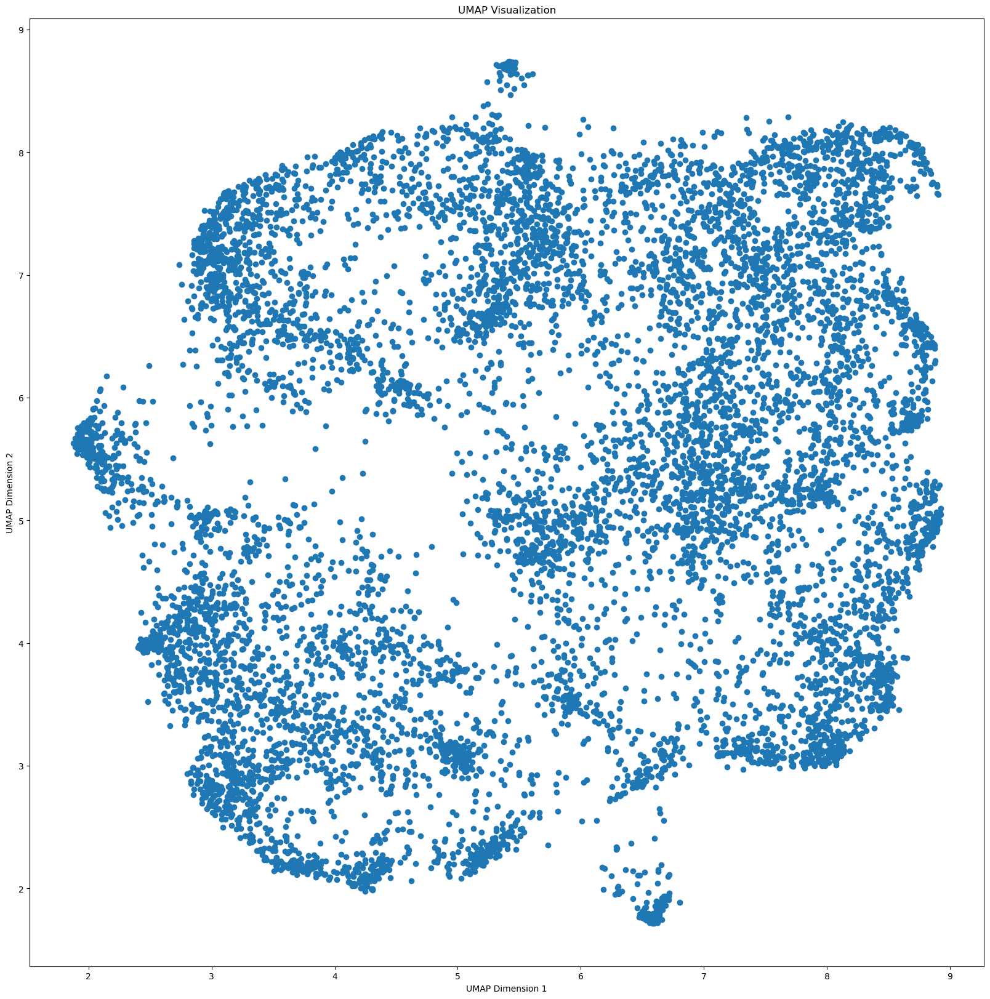

# Vectors:  9700


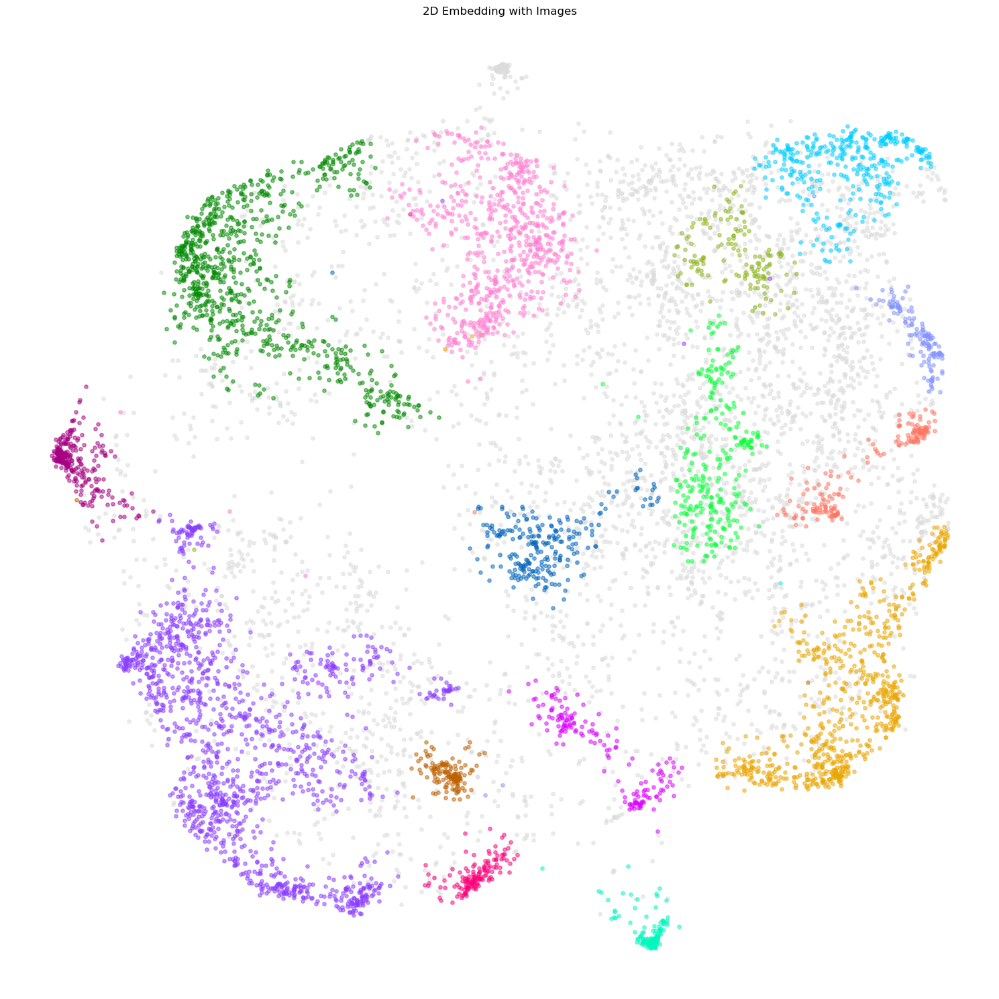

# Vectors:  9700


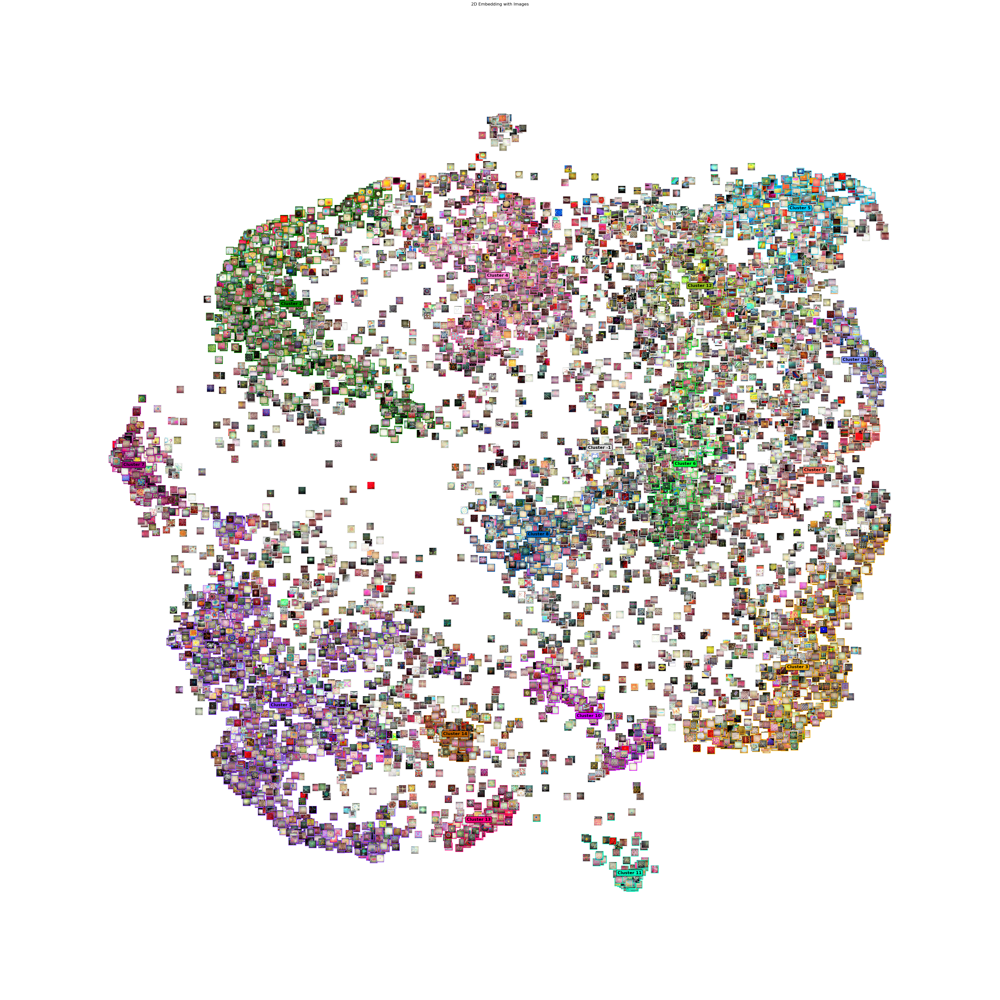

In [67]:
from sklearn.cluster import HDBSCAN
import pickle

vectors = fv_reduced["l2"]

umap_model = umap.UMAP(
n_components=6,
n_neighbors=100,
min_dist=0,
random_state=42,
metric="cosine"
).fit_transform(vectors)

hdbscan_model = HDBSCAN(min_cluster_size=100, min_samples=22, metric="cosine", store_centers="medoid").fit(umap_model)
hdbscan_model.labels_ = utils.relabel_by_size(hdbscan_model.labels_)

path_to_save = Path(base_dir) / 'outputs' / 'cache'
filename = 'hdbscan_l2norm_90pca_6components_100nn_0dist_cosine_42randseed_100_minclustsize_22minsamples.pkl'
with open(path_to_save / filename, 'wb') as file:
    pickle.dump(hdbscan_model, file)

for i in range(-1, max(hdbscan_model.labels_)+1):
    n_points = np.sum(hdbscan_model.labels_ == i)
    print(f"Cluster {i}: {n_points} points")

umap2d = utils.plot_umap(vectors,
                    model_dict,
                    show_images=False,
                    zoom=0.3,
                    n_neighbors=100,
                    min_dist=0)

utils.print_projection(hdbscan_model.labels_, model_dict, umap2d, show_images=False, zoom=0.4)
utils.print_projection(hdbscan_model.labels_, model_dict, umap2d, show_images=True, zoom=0.4)

### Checking the cluster using alternative package (hdbscan)

In [68]:
vectors = fv_reduced["l2"]

umap_model = umap.UMAP(
n_components=6,
n_neighbors=100,
min_dist=0,
random_state=42,
metric="cosine"
).fit_transform(vectors)

# umap_embedding is the 2‑D array returned by UMAP
umap_model = np.asarray(umap_model, dtype=np.float64)

"""# scikit‑learn version: add 1 to min_cluster_size and min_samples
sk_model = sklearn.cluster.HDBSCAN(min_cluster_size=100, min_samples=22,
                                   metric="cosine").fit(umap_model)"""

hdbscan_model= hdbscan.HDBSCAN(min_cluster_size=99,
                    min_samples=21,
                    metric="cosine",
                    algorithm="generic").fit(umap_model)

hdbscan_model.labels_ = utils.relabel_by_size(hdbscan_model.labels_)

for i in range(-1, max(hdbscan_model.labels_)+1):
    n_points = np.sum(hdbscan_model.labels_ == i)
    print(f"Cluster {i}: {n_points} points")

"""for i in range(-1, max(sk_model.labels_)+1):
    n_points = np.sum(sk_model.labels_ == i)
    print(f"Cluster {i}: {n_points} points")
    """
    
print(validity_index(umap_model, hdbscan_model.labels_, metric="cosine"))

Cluster -1: 3964 points
Cluster 0: 0 points
Cluster 1: 1377 points
Cluster 2: 821 points
Cluster 3: 702 points
Cluster 4: 645 points
Cluster 5: 352 points
Cluster 6: 279 points
Cluster 7: 267 points
Cluster 8: 236 points
Cluster 9: 175 points
Cluster 10: 162 points
Cluster 11: 154 points
Cluster 12: 145 points
Cluster 13: 144 points
Cluster 14: 144 points
Cluster 15: 133 points
0.37882869020245563


<Axes: ylabel='$\\lambda$ value'>

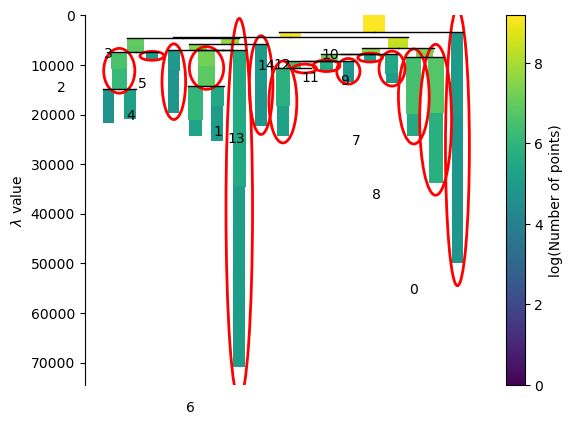

In [69]:
hdbscan_model.condensed_tree_.plot(leaf_separation=1,
select_clusters=True,
label_clusters=True,
log_size=True,
max_rectangles_per_icicle=2)

# Plotting


## Imports/Setup

In [ ]:
# Additional imports for visualization
from sklearn.base import clone
from sklearn.cluster import KMeans
from matplotlib.offsetbox import AnnotationBbox, DrawingArea, OffsetImage, TextArea
from matplotlib.textpath import TextPath
from matplotlib.font_manager import FontProperties

# HDBSCAN model filename
hdbscan_filename = 'hdbscan_l2norm_90pca_6components_100nn_0dist_cosine_42randseed_100_minclustsize_22minsamples.pkl'
with open(cache_dir / hdbscan_filename, 'rb') as file:
    hdbscan_model = pkl.load(file)

hdbscan_model.labels_ = utils.relabel_by_size(hdbscan_model.labels_)

# UMAP embeddings paths L2, No PCA
umap_model_path = 'umap_embeddings_6d_100nn.pkl'
umap_2d_path = 'umap_embeddings_2d_100nn.pkl'
umap_2d_150_path = 'umap_embeddings_2d_150nn.pkl'

# # UMAP embeddings paths L2, Reduced PCA
umap_model_path_l2_red = 'umap_l2_red_embeddings_6d_100nn.pkl'
umap_2d_path_l2_red = 'umap_l2_red_embeddings_2d_100nn.pkl'
umap_2d_150_path_l2_red = 'umap_l2_red_embeddings_2d_150nn.pkl'

# UMAP embeddings paths L2, No PCA
with open(os.path.join(path_to_save, umap_model_path), "rb") as file:
    umap_model = pkl.load(file)
with open(os.path.join(path_to_save, umap_2d_path), "rb") as file:
    umap_2d = pkl.load(file)
with open(os.path.join(path_to_save, umap_2d_150_path), "rb") as file:
    umap_2d_150 = pkl.load(file)
    
# # UMAP embeddings paths L2, Reduced PCA
with open(os.path.join(path_to_save, umap_model_path_l2_red), "rb") as file:
    umap_model_l2_red = pkl.load(file)
with open(os.path.join(path_to_save, umap_2d_path_l2_red), "rb") as file:
    umap_2d_l2_red = pkl.load(file)
with open(os.path.join(path_to_save, umap_2d_150_path_l2_red), "rb") as file:
    umap_2d_150_l2_red = pkl.load(file)


## Save Cluster Drawings in Folders

In [71]:
dir = os.path.join(base_dir, 'clusters')
os.makedirs(dir, exist_ok=False) # If exists, will throw error

model_dict['filenames']
image_dir = model_dict['image_dir']

# Group filenames and distances by cluster
clustered_filenames = {}

# Group filenames by cluster
for filename, label in zip(filenames, hdbscan_model.labels_):
    if label not in clustered_filenames:
        clustered_filenames[label] = []
    clustered_filenames[label].append(filename)

# Sort the dictionaries by the length of the lists in their keys
sorted_clusters = sorted(clustered_filenames.items(), key=lambda item: len(item[1]))

# Group filenames by cluster
for cluster, images in clustered_filenames.items():

    cluster_dir = f'{dir}/cluster_{cluster}'

    # os.makedirs(cluster_dir, exist_ok=False) #### UNCOMMENT TO SAVE

    for filename in images:
        image = cv2.imread(os.path.join(image_dir, filename))
        #cv2.imwrite(f'{cluster_dir}/{filename}', image) #### UNCOMMENT TO SAVE

FileExistsError: [Errno 17] File exists: '/Users/ethangrove/Developer/projects/dreamachine_paper/code_projects/clustering_new/clusters'

## Save All Drawings Sorted by Cluster to PDF

In [ ]:
utils.print_cluster_pdf(hdbscan_model, 
                    vectors,
                    model_dict,
                    save_filename="cluster_images.pdf",
                    show=False,
                    sort="random")

## Import Labels

In [ ]:
import pandas as pd
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.gridspec as gridspec
from collections import defaultdict

# Labels
labels_path = os.path.join(base_dir, "data/cluster_labels.xlsx") # path to the labels file
labels_df = pd.read_excel(labels_path, sheet_name='Sheet1')

labels_df['cluster'] = pd.to_numeric(labels_df['cluster'], errors='coerce').round().astype('Int64')
labels_df = labels_df.dropna(subset=['cluster']).copy()
labels_df['cluster'] = labels_df['cluster'].astype(int)
labels_df['category'] = labels_df['category'].astype(str).str.strip().str.lower()

n_clusters = len(set(hdbscan_model.labels_))

label_order = ['kluverian', 'non-kluverian', 'non-geometric', "noise"]

for label in label_order:
    print(label)
    clusters_for_label = labels_df[labels_df['category'] == label]['cluster'].tolist()
    num_images = labels_df[labels_df['category'] == label]['quantity'].sum()
    print(f'# Clusters = {len(clusters_for_label)}, {len(clusters_for_label)/n_clusters*100:.2f}% of total clusters')
    print(f'# Images = , {num_images}, {num_images/len(filenames)*100:.2f}% of total images')

## UMAP DataMapPlots (Figure 3)

In [ ]:
hdbscan_description_labels = []

hdbscan_model.labels_ = utils.relabel_by_size(hdbscan_model.labels_)

for label in hdbscan_model.labels_:
    if label == -1:
        hdbscan_description_labels.append('Unlabelled')
    else:
        hdbscan_description_labels.append(label)

print(len(hdbscan_description_labels))

datamapplot.create_plot(umap_2d,
                        hdbscan_description_labels,
                        color_label_text=False,
                        label_over_points=True,
                        label_font_size=24,
                        )

## Randomly Selected Images in Each Cluster by Category (Figure 4)

kluverian


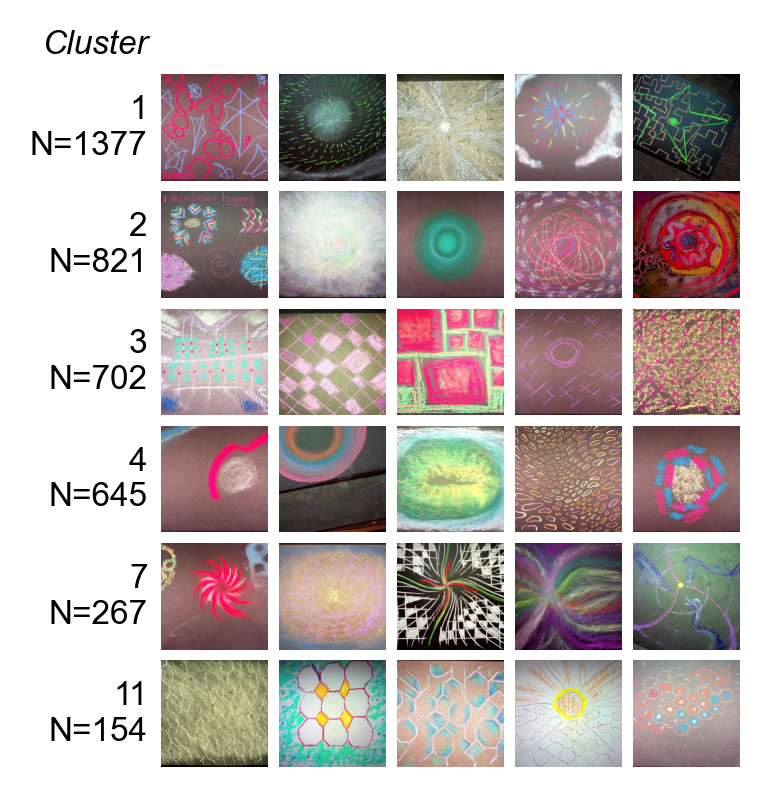

non-kluverian


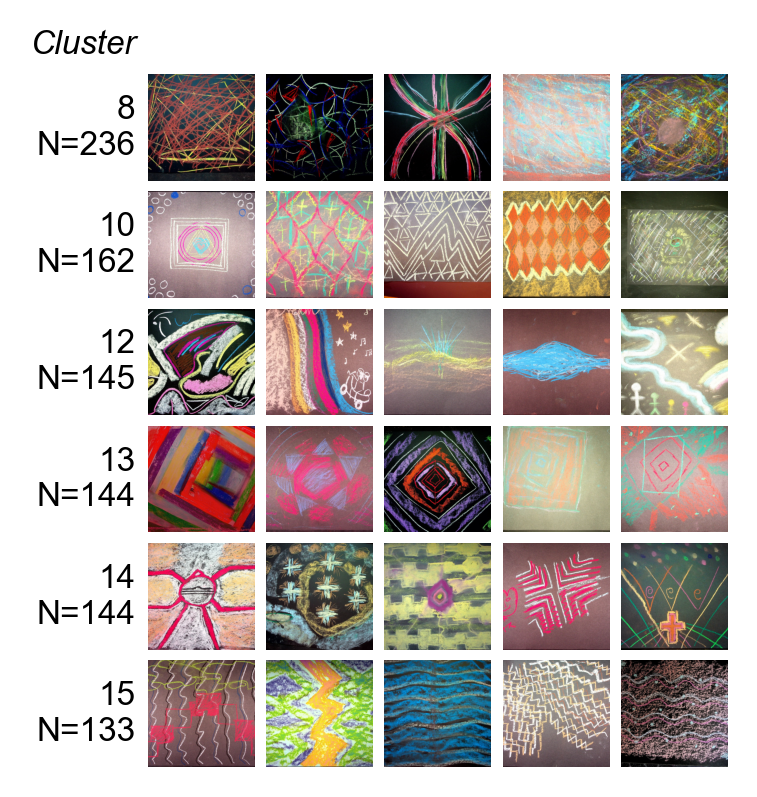

non-geometric


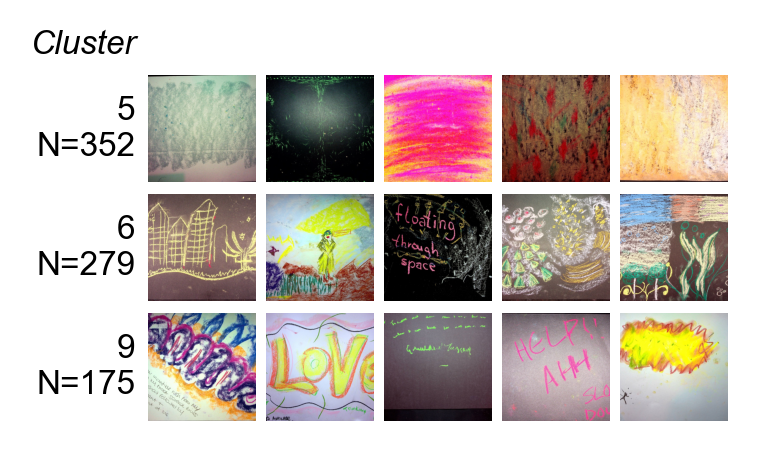

noise


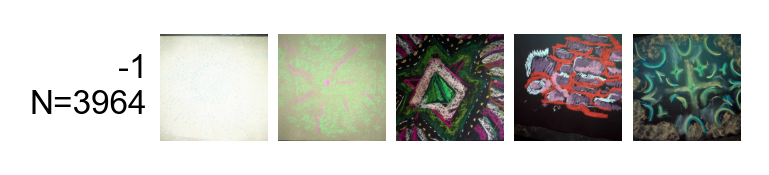

In [ ]:
def plot_label_figs(num_columns=6,
                    num_clust_columns=1,
                    image_selection="medoid",
                    seed=42,
                    include_noise=True,
                    label_order=label_order):
    """
    image_selection:
      - "medoid"/"mediod": nearest to cluster medoid (first image is medoid)
      - "random": random order, reproducible with `seed`
    Excludes cluster -1.
    """
    # RNG: re-init every call => identical output for same seed
    rng = np.random.default_rng(seed)

    # grid sanity
    assert isinstance(num_columns, int) and num_columns >= 2
    assert isinstance(num_clust_columns, int) and num_clust_columns >= 1

    # labels & filenames
    clusters_ = hdbscan_model.labels_.astype(int)
    filenames = np.asarray(model_dict['filenames'])
    image_dir = model_dict['image_dir']

    # feature space for medoid computation
    try:
        X = umap_model  # embedding array from your Cell 2
    except NameError:
        X = vectors
    if X.shape[0] != len(filenames):
        X = vectors  # fallback if mismatch

    # cluster -> indices (exclude -1)
    cluster_indices = defaultdict(list)
    for i, lbl in enumerate(clusters_):
        if include_noise and lbl == -1:
            cluster_indices[int(lbl)].append(i)
        elif lbl != -1:
            cluster_indices[int(lbl)].append(i)

    # build per-cluster ordered filename lists
    clustered_filenames = {}

    if image_selection == "medoid":
        for lbl in sorted(cluster_indices.keys()):   # sorted => stable
            idxs = cluster_indices[lbl]
            Xi = X[idxs]
            if len(idxs) == 0:
                continue
            # Euclidean medoid
            diff = Xi[:, None, :] - Xi[None, :, :]
            D = np.linalg.norm(diff, axis=2)
            medoid_local = np.argmin(D.sum(axis=1))
            d_to_medoid = D[:, medoid_local]
            order = np.argsort(d_to_medoid)          # medoid first
            clustered_filenames[lbl] = [filenames[idxs[k]] for k in order]
        note_text = "closest to\nmedoid"
    elif image_selection == "random":
        for lbl in sorted(cluster_indices.keys()):   # sorted => stable across calls
            idxs = cluster_indices[lbl]
            if len(idxs) == 0:
                continue
            order = rng.permutation(len(idxs))       # uses our local, re-seeded RNG
            clustered_filenames[lbl] = [filenames[idxs[k]] for k in order]
        note_text = ""
    else:
        raise ValueError("image_selection must be 'medoid'/'mediod' or 'random'")

    # plot: one figure per label (labels_df already sorted by size)
    for category in label_order:
        print(category)
        target_clusters = labels_df.loc[labels_df['category'] == category, 'cluster'].astype(int).tolist()
        target_clusters = [c for c in target_clusters if c != -1 or include_noise]

        num_rows = len(target_clusters)
        if num_rows == 0:
            continue

        fig = plt.figure(figsize=(3, num_rows * (3/(num_clust_columns * num_columns))),
                         facecolor="white", dpi=300)
        outer_grid = gridspec.GridSpec(num_rows, num_clust_columns, wspace=0.02, hspace=0.1)
        clusters_plotted = 0

        for cluster_id in target_clusters:
            images = clustered_filenames.get(cluster_id, [])
            if not images:
                continue

            col = (clusters_plotted // num_rows)
            row = (clusters_plotted % num_rows)
            inner_grid = gridspec.GridSpecFromSubplotSpec(
                1, num_columns, subplot_spec=outer_grid[row, col], wspace=0.1, hspace=0
            )
            clusters_plotted += 1

            for plot_idx in range(num_columns):
                ax = fig.add_subplot(inner_grid[0, plot_idx])

                if clusters_plotted == 1 and plot_idx == 0:
                    if cluster_id != -1:
                        ax.text(0.5, 1.13, "Cluster", fontsize=8, ha='center', va='bottom', fontstyle='italic', fontfamily="arial")

                    ax.text(1.6, 1.1, note_text, fontsize=8, ha='center', va='bottom', fontstyle='italic', fontfamily="arial")

                if plot_idx == 0:
                    dser = labels_df.loc[labels_df['cluster'] == cluster_id, 'description']
                    desc = dser.iloc[0] if not dser.empty else None
                    include_desc = (isinstance(desc, str) and desc.strip() != "") and not pd.isna(desc)

                    text = f"{cluster_id}\nN={len(images)}" #if not include_desc else f"{cluster_id}\n{desc.strip()}\nN={len(images)}"
                    ax.text(0.98, 0.5, text, ha='right', va='center',
                            fontsize=8, transform=ax.transAxes, wrap=True, fontfamily="arial")
                    ax.set_xlim(0, 1); ax.set_ylim(0, 1)
                    ax.margins(0); ax.axis('off')
                else:
                    img_idx = plot_idx - 1
                    if img_idx < len(images):
                        fname = images[img_idx]
                        img = cv2.imread(os.path.join(image_dir, str(fname)))
                        if img is not None:
                            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                            ax.imshow(img)
                    ax.axis('off')

        plt.show()
        
plot_label_figs(num_columns=6,
                num_clust_columns=1,
                image_selection="random",
                seed=42)

## UMAP Plot of Cluster with Selected Figures (Figure 5)

# Vectors:  9700


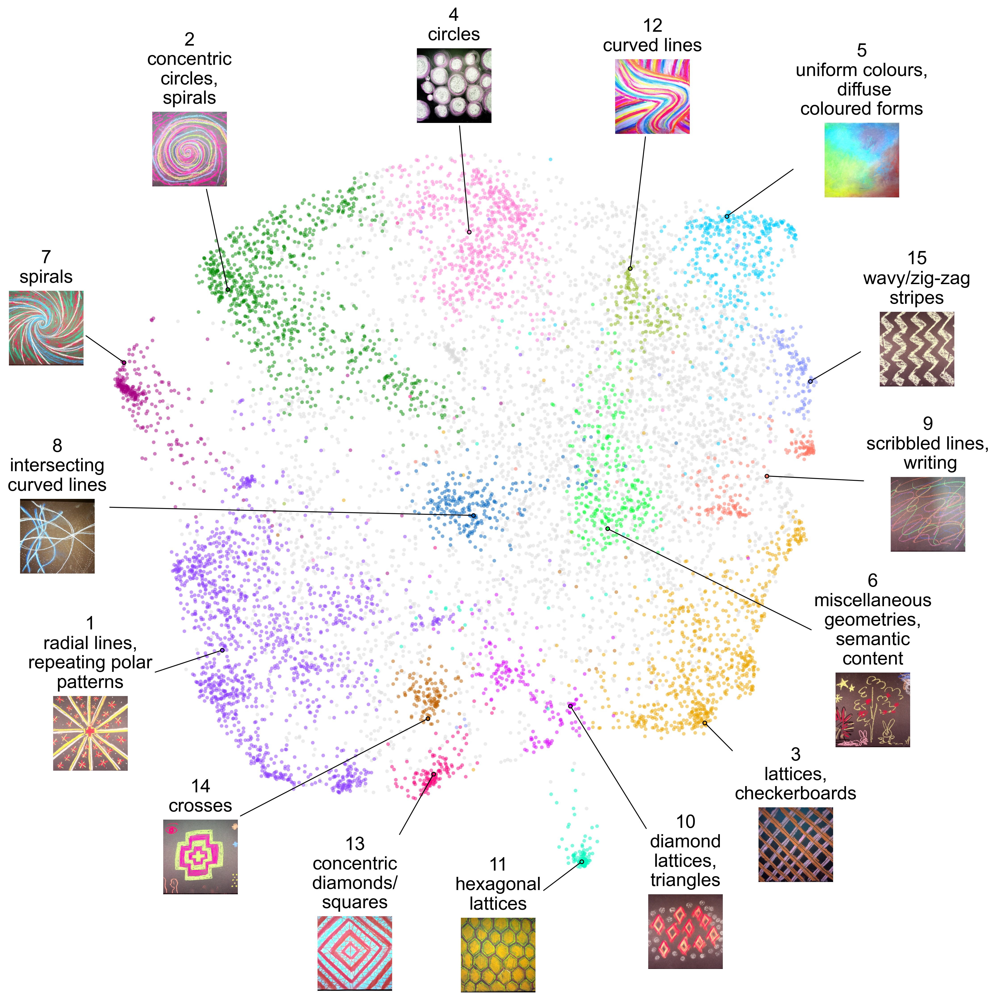

In [ ]:
utils.print_projection_selected_images(hdbscan_model.labels_,
                       model_dict,
                       umap_2d_150,
                       image_labels="selected",
                       cluster_descriptions=labels_df,
                       hdbscan_model=hdbscan_model,
                       zoom=0.2,
                       )